# Xenium Alzherimer mouse

In [1]:
import os
import scanpy as sc
import pandas as pd
import warnings

# suppress all warnings
warnings.filterwarnings("ignore")

In [2]:
base_dir = '/Users/christoffer/Downloads/xenium_alzheimer'

# Only keep subfolders matching "GoncaloTing"
runs = [d for d in os.listdir(base_dir) if 'Xenium' in d]

## Create adata from publically availible data

In [3]:
ad_list = []

for run in runs:
    print
    sample_path = os.path.join(base_dir, run)

    h5_path = os.path.join(sample_path, 'cell_feature_matrix.h5')
    cell_info_path = os.path.join(sample_path, 'cells.csv.gz')

    if not (os.path.exists(h5_path) and os.path.exists(cell_info_path)):
        print(f"Skipping {sample_path} (missing required files)")
        continue

    print(f"Loading sample: {sample_path}")
    ad_int = sc.read_10x_h5(h5_path)
    cell_info = pd.read_csv(cell_info_path, index_col=0)

    ad_int.obs = cell_info
    ad_int.obs['run'] = run
    ad_list.append(ad_int)

Loading sample: /Users/christoffer/Downloads/xenium_alzheimer/Xenium_V1_FFPE_TgCRND8_5_7_months_outs
Loading sample: /Users/christoffer/Downloads/xenium_alzheimer/Xenium_V1_FFPE_wildtype_2_5_months_outs
Loading sample: /Users/christoffer/Downloads/xenium_alzheimer/Xenium_V1_FFPE_wildtype_13_4_months_outs
Loading sample: /Users/christoffer/Downloads/xenium_alzheimer/Xenium_V1_FFPE_wildtype_5_7_months_outs
Loading sample: /Users/christoffer/Downloads/xenium_alzheimer/Xenium_V1_FFPE_TgCRND8_2_5_months_outs
Loading sample: /Users/christoffer/Downloads/xenium_alzheimer/Xenium_V1_FFPE_TgCRND8_17_9_months_outs


In [4]:
ad = sc.concat(ad_list)

In [5]:
sc.pp.calculate_qc_metrics(ad, percent_top=None, log1p=False, inplace=True)
sc.pp.filter_cells(ad,min_counts=30)
sc.pp.filter_cells(ad,min_genes=15)

In [6]:
sc.pp.normalize_total(ad, inplace=True,target_sum=100)
sc.pp.log1p(ad)
#sc.pp.scale(ad, )#max_value=10)

In [7]:
import matplotlib.pyplot as plt

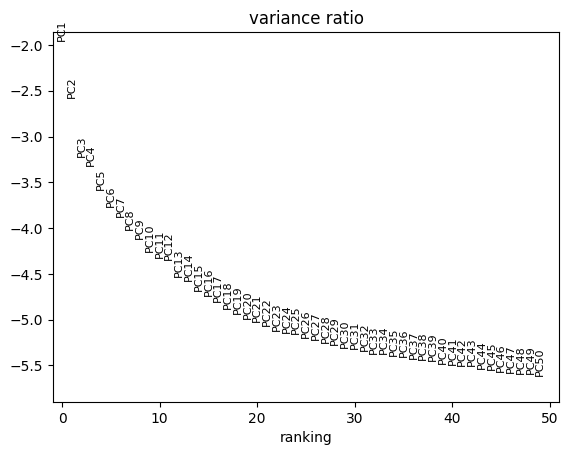

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [8]:
plt.rcdefaults()
sc.tl.pca(ad)
sc.pl.pca_variance_ratio(ad, n_pcs=50, log=True)
sc.pp.neighbors(ad, n_neighbors=15, n_pcs=30)

In [9]:
sc.tl.umap(ad, min_dist=0.1)

In [10]:
resolutions = [0.5, 1, 1.5 , 2, 2.5]
for resolution in resolutions: 
    print('clustering at resolution '+str(resolution))
    sc.tl.leiden(ad, resolution = resolution, key_added = 'leiden_'+str(resolution))
    print("done")

clustering at resolution 0.5
done
clustering at resolution 1
done
clustering at resolution 1.5
done
clustering at resolution 2


IOStream.flush timed out


done
clustering at resolution 2.5


IOStream.flush timed out
IOStream.flush timed out


done


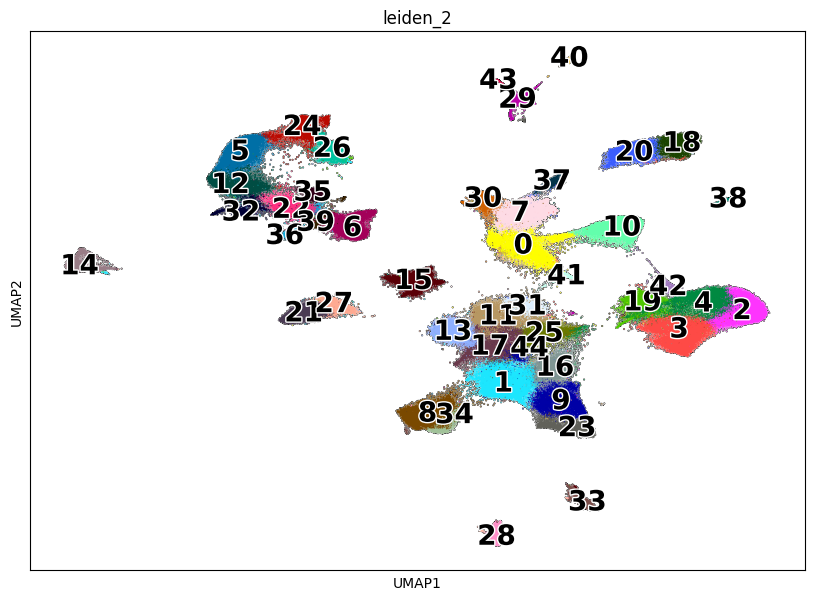

In [11]:
plt.rcdefaults()
with plt.rc_context({'figure.figsize': (10, 7)}):
    sc.pl.umap(ad,color = ("leiden_2"),s=3,add_outline=True,legend_loc='on data',legend_fontsize=20,legend_fontoutline=2, ncols= 1, )

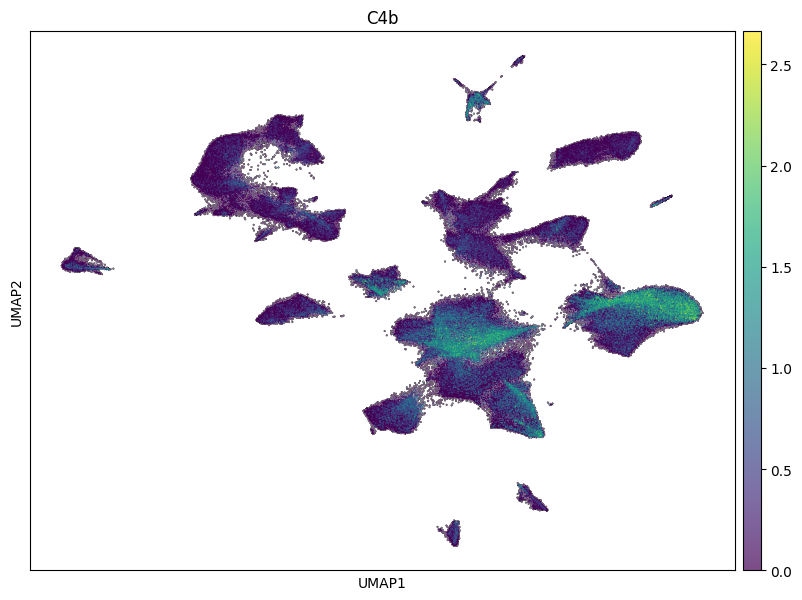

In [12]:
plt.rcdefaults()
with plt.rc_context({'figure.figsize': (10, 7)}):
    sc.pl.umap(ad,color = ("C4b"),s=3,add_outline=True,legend_loc='on data',legend_fontsize=20,legend_fontoutline=2, ncols= 1, )

In [13]:
import numpy as np

In [14]:
spatial = np.array(ad.obs[['x_centroid','y_centroid']])
ad.obsm['spatial'] = spatial

Xenium_V1_FFPE_TgCRND8_5_7_months_outs


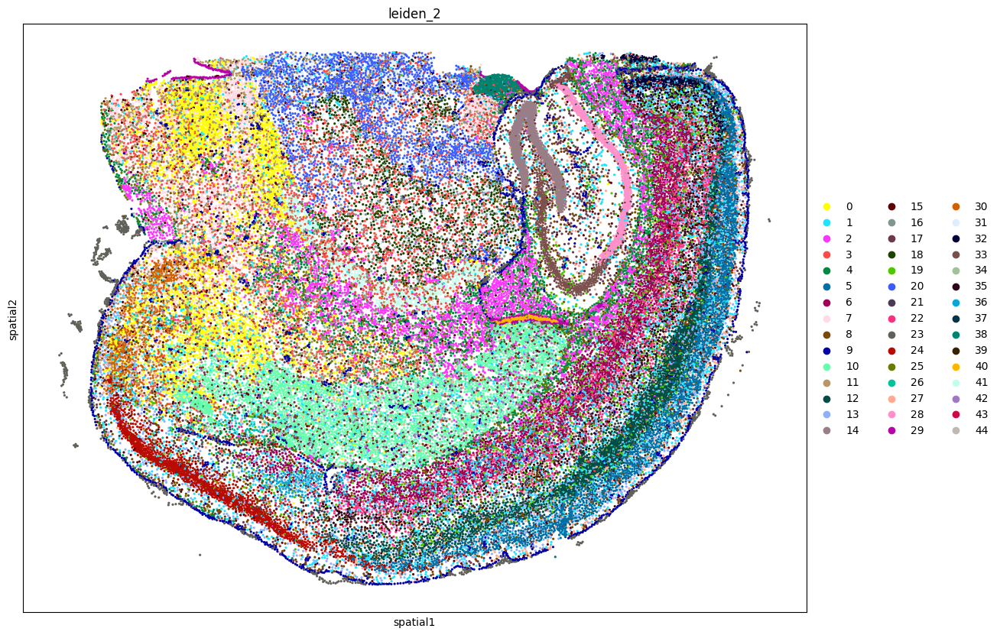

Xenium_V1_FFPE_wildtype_2_5_months_outs


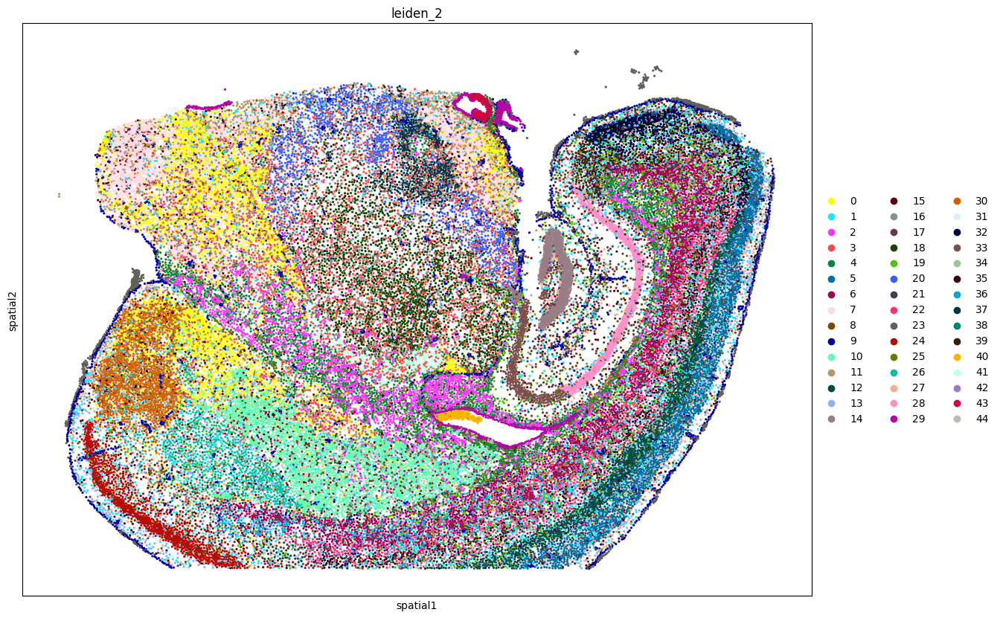

Xenium_V1_FFPE_wildtype_13_4_months_outs


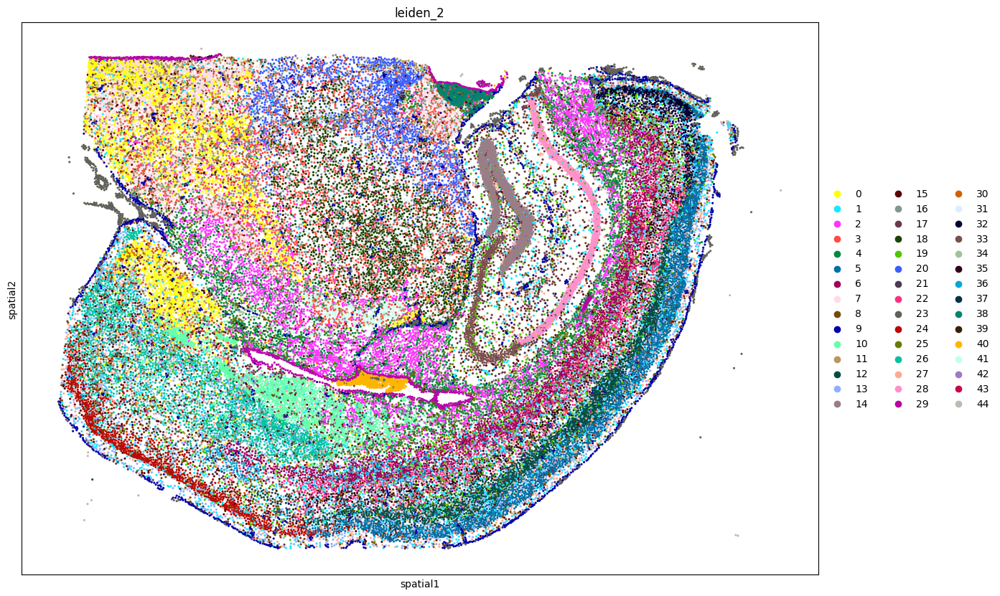

Xenium_V1_FFPE_wildtype_5_7_months_outs


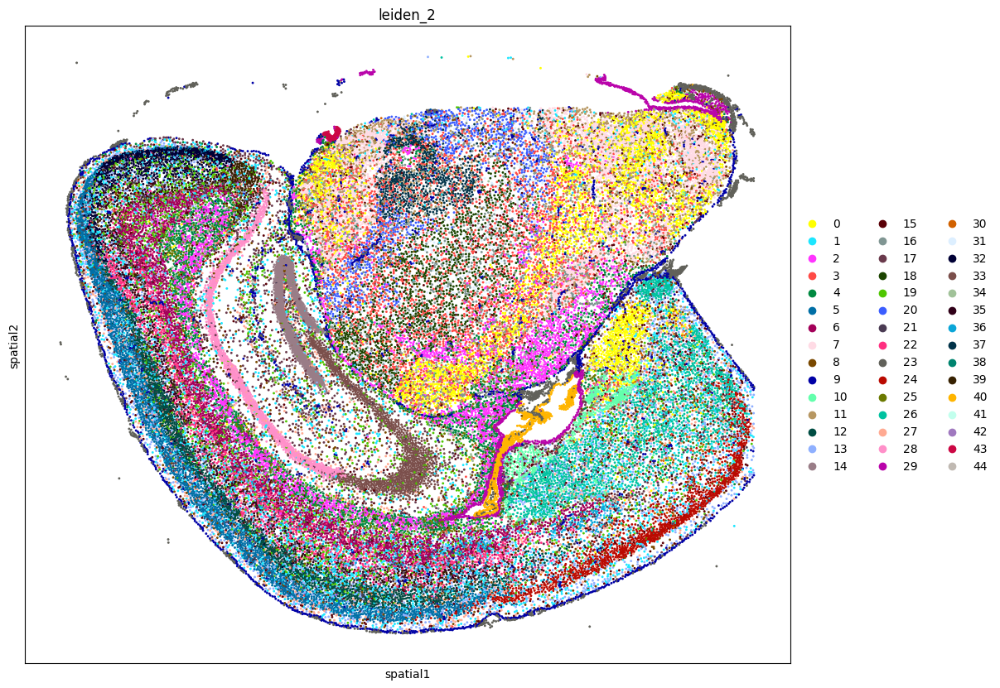

Xenium_V1_FFPE_TgCRND8_2_5_months_outs


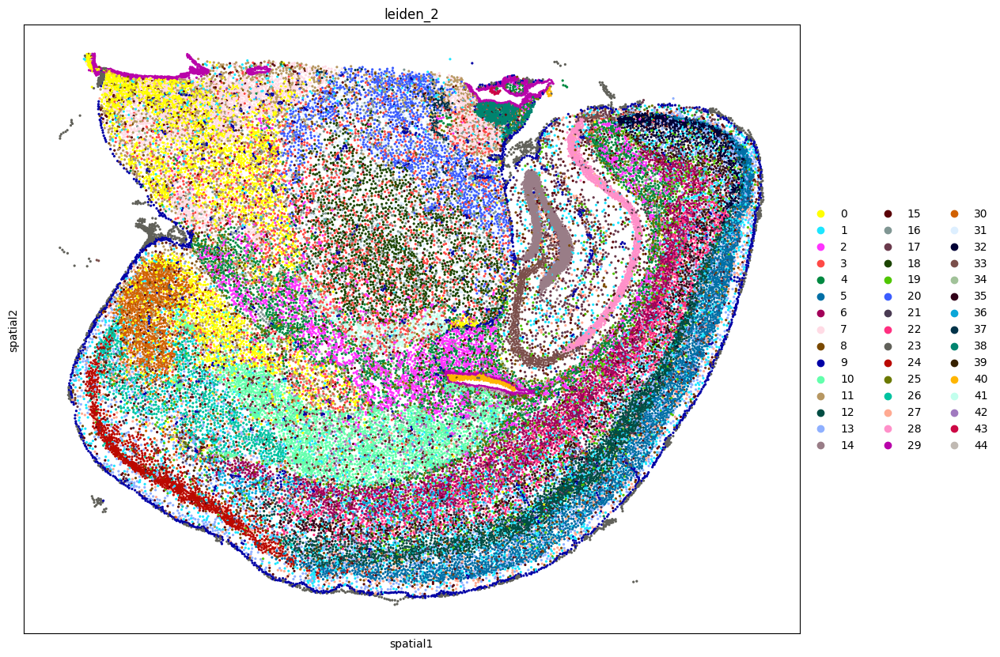

Xenium_V1_FFPE_TgCRND8_17_9_months_outs


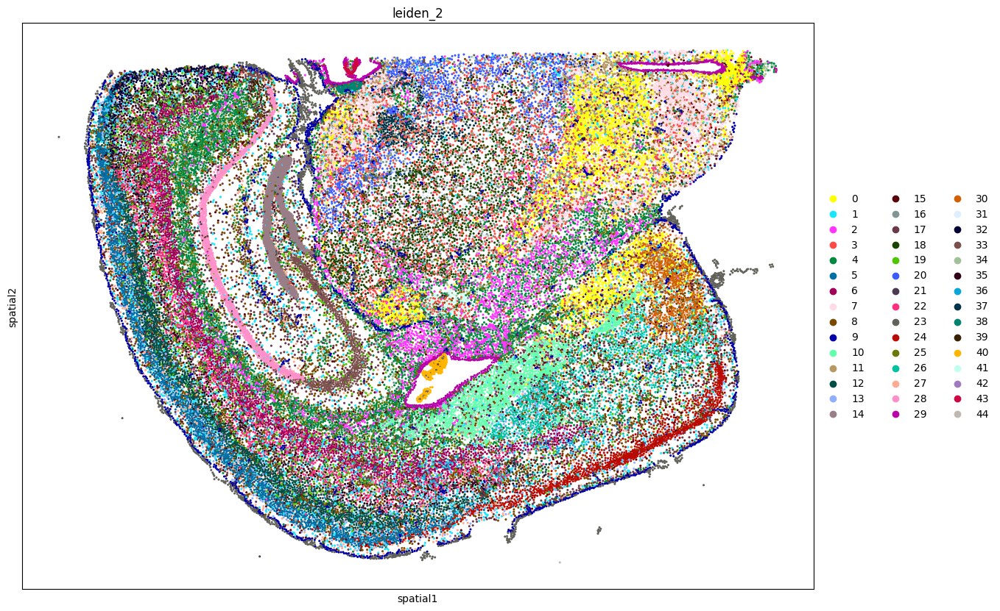

In [15]:
for run in ad.obs['run'].unique():
    print(run)
    ad_int = ad[ad.obs['run'] == run]
    with plt.rc_context({'figure.figsize': (20, 10)}):
        sc.pl.spatial(ad_int, spot_size=20, color = 'leiden_2')
    plt.show()
    

## Cluster annotation

In [16]:
sc.tl.rank_genes_groups(ad, groupby='leiden_2', method='wilcoxon')

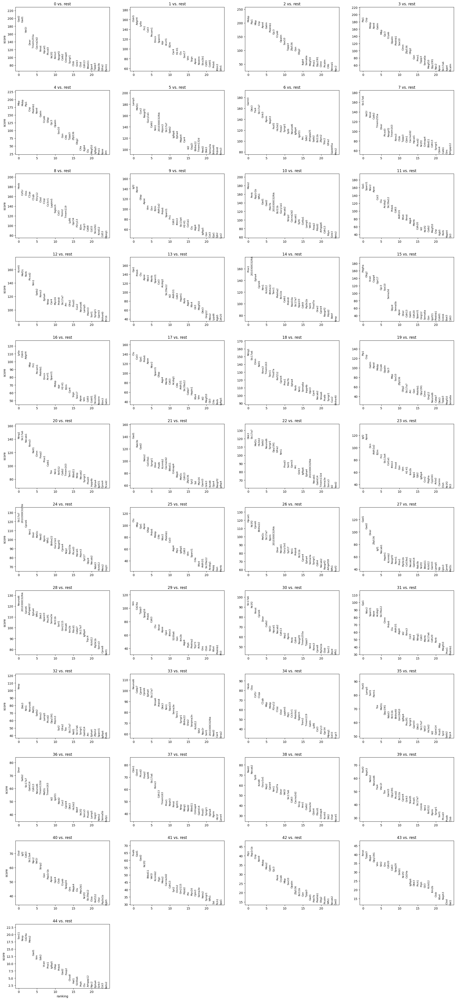

In [17]:
# See top 5 marker genes per cluster
sc.pl.rank_genes_groups(ad, n_genes=25, sharey=False)

In [18]:
marker_genes = pd.DataFrame({
    group: ad.uns['rank_genes_groups']['names'][group][:5]
    for group in ad.uns['rank_genes_groups']['names'].dtype.names
})
marker_genes.head()
#marker_genes.to_csv('../data/broad_markers_leiden0-5.csv')

,0,1,2,3,4,5,6,7,8,9,...,35,36,37,38,39,40,41,42,43,44
0,Gad2,Cldn5,Mobp,Plp1,Mbp,Lamp5,Garnl3,Slc17a6,Hexb,Igf2,...,Fezf2,Dner,Cbln1,Nwd2,Fezf2,Ctsd,Pvalb,Plp1,Rmst,Sox11
1,Gad1,Adgrl4,Plp1,Cnp,Mobp,Mef2c,Dkk3,Vat1l,Csf1r,Apod,...,Lamp5,Satb2,Cbln4,Necab2,Nxph3,Igf2,Gad1,Ppp1r1b,Tppp3,Nrep
2,Vat1l,Ly6a,Mbp,Mobp,Plp1,Cux2,Tle4,Rmst,Ctss,Gfap,...,Sorl1,Slc17a7,Plcxd2,Syt6,Neto2,Cd63,Gad2,Cnp,Rbp4,Cd24a
3,Dner,Fn1,Cnp,Apod,Cnp,Rasgrf2,Slc17a7,Calb2,C1qa,Apoe,...,Parm1,Galnt14,Foxp2,Kctd8,Neurod6,Slc13a4,Nr2f2,Apod,Dpy19l1,Meis2
4,Tmem255a,Cst3,Apod,Gatm,Plekhb1,Gucy1a1,Grik3,Tmem255a,C1qb,Vim,...,Tox,Cdh13,Lypd6,Gucy1a1,Tle4,Npc2,Btbd11,Mobp,Vim,Gad1


In [19]:
marker_genes = marker_genes.T

In [20]:
marker_genes = marker_genes.reset_index().rename(columns={'index':'cluster'})

In [21]:
marker_genes = marker_genes.set_index("cluster").T.to_dict("list")

In [24]:
marker_genes = {'0': ['Gad2', 'Gad1', 'Vat1l', 'Dner', 'Tmem255a'],
 '1': ['Cldn5', 'Adgrl4', 'Ly6a', 'Fn1', 'Cst3'],
 '2': ['Mobp', 'Plp1', 'Mbp', 'Cnp', 'Apod'],
 '3': ['Plp1', 'Cnp', 'Mobp', 'Apod', 'Gatm'],
 '4': ['Mbp', 'Mobp', 'Plp1', 'Cnp', 'Plekhb1'],
 '5': ['Lamp5', 'Mef2c', 'Cux2', 'Rasgrf2', 'Gucy1a1'],
 '6': ['Garnl3', 'Dkk3', 'Tle4', 'Slc17a7', 'Grik3'],
 '7': ['Slc17a6', 'Vat1l', 'Rmst', 'Calb2', 'Tmem255a'],
 '8': ['Hexb', 'Csf1r', 'Ctss', 'C1qa', 'C1qb'],
 '9': ['Igf2', 'Apod', 'Gfap', 'Apoe', 'Vim'],
 '10': ['Meis2', 'Penk', 'Ppp1r1b', 'Wfs1', 'Gad1'],
 '11': ['Gja1', 'Sparcl1', 'Ntsr2', 'Apoe', 'Cst3'],
 '12': ['Kcnh5', 'Mef2c', 'Rorb', 'Plcxd2', 'Nrn1'],
 '13': ['Gja1', 'Prdx6', 'Clu', 'Apoe', 'Ntsr2'],
 '14': ['Prox1', '2010300C02Rik', 'Epha4', 'Cpne6', 'Nrn1'],
 '15': ['Pdgfra', 'Olig2', 'Vcan', 'Cspg4', 'Gpr17'],
 '16': ['Ly6a', 'Cldn5', 'Adgrl4', 'Mbp', 'Fn1'],
 '17': ['Clu', 'Cst3', 'Gja1', 'Prdx6', 'Apoe'],
 '18': ['Ntng1', 'Slc17a6', 'Clmn', 'Nell1', 'Rims3'],
 '19': ['Plp1', 'Cnp', 'Gatm', 'Apod', 'Mobp'],
 '20': ['Ntng1', 'Slc17a6', 'Necab1', 'Rims3', 'Nell1'],
 '21': ['Gad1', 'Rab3b', 'Gad2', 'Neto2', 'Col19a1'],
 '22': ['Dkk3', 'Slc17a7', 'Mef2c', 'Hs3st2', 'Satb2'],
 '23': ['Igf2', 'Apod', 'Dcn', 'Aldh1a2', 'B2m'],
 '24': ['Slc17a7', '2010300C02Rik', 'Cpne6', 'Nrn1', 'Dner'],
 '25': ['Clu', 'Mbp', 'Gja1', 'Apoe', 'Gfap'],
 '26': ['Hpcal1', 'Nr2f2', 'Cpne6', 'Bhlhe22', 'Mef2c'],
 '27': ['Gad1', 'Gad2', 'Dner', 'Zfp536', 'Igf1'],
 '28': ['Neurod6', '2010300C02Rik', 'Cpne6', 'Arhgap12', 'Epha4'],
 '29': ['Vim', 'Cd24a', 'Tppp3', 'Spag16', 'Prdx6'],
 '30': ['Slc17a6', 'Nr2f2', 'Rmst', 'Cpne6', 'Dner'],
 '31': ['Gja1', 'Ntsr2', 'Sparcl1', 'Apoe', 'Acsbg1'],
 '32': ['Nrep', 'Dkk3', 'Nrn1', 'Neurod6', 'Mef2c'],
 '33': ['Neurod6', 'Cabp7', 'Cpne4', 'Cpne6', 'Epha4'],
 '34': ['Hexb', 'Ctss', 'Csf1r', 'C1qa', 'C1qb'],
 '35': ['Fezf2', 'Lamp5', 'Sorl1', 'Parm1', 'Tox'],
 '36': ['Dner', 'Satb2', 'Slc17a7', 'Galnt14', 'Cdh13'],
 '37': ['Cbln1', 'Cbln4', 'Plcxd2', 'Foxp2', 'Lypd6'],
 '38': ['Nwd2', 'Necab2', 'Syt6', 'Kctd8', 'Gucy1a1'],
 '39': ['Fezf2', 'Nxph3', 'Neto2', 'Neurod6', 'Tle4'],
 '40': ['Ctsd', 'Igf2', 'Cd63', 'Slc13a4', 'Npc2'],
 '41': ['Pvalb', 'Gad1', 'Gad2', 'Nr2f2', 'Btbd11'],
 '42': ['Plp1', 'Ppp1r1b', 'Cnp', 'Apod', 'Mobp'],
 '43': ['Rmst', 'Tppp3', 'Rbp4', 'Dpy19l1', 'Vim'],
 '44': ['Sox11', 'Nrep', 'Cd24a', 'Meis2', 'Gad1']}

# Use mllmcelltype to annotate clusters

In [25]:
from mllmcelltype import annotate_clusters, setup_logging

In [26]:
from dotenv import load_dotenv
import os

load_dotenv()  # will read .env into environment
api_key = os.getenv("../OPENAI_API_KEY")

In [27]:
import os

# Annotate clusters with a single model
annotations = annotate_clusters(
    marker_genes=marker_genes,  # DataFrame or dictionary of marker genes
    species='mouse',               # Organism species
    provider='openai',            # LLM provider
    model='gpt-4o-mini',               # Specific model
    tissue='brain'                #Tissue context (optional but recommended)
)

# Print annotations
for cluster, annotation in annotations.items():
    print(f"Cluster {cluster}: {annotation}")

2025-09-22 10:09:32 - llmcelltype - INFO - Logging initialized. Log file: /Users/christoffer/.llmcelltype/logs/llmcelltype_20250922_100932.log
2025-09-22 10:09:32 - llmcelltype - INFO - Starting annotation with provider: openai
2025-09-22 10:09:32 - llmcelltype - INFO - Found 45 clusters
2025-09-22 10:09:32 - llmcelltype - INFO - Creating prompt for 45 clusters
2025-09-22 10:09:32 - llmcelltype - INFO - Generated prompt with 2651 characters
2025-09-22 10:09:32 - llmcelltype - INFO - Loaded results from cache (version 1.0): /Users/christoffer/.llmcelltype/cache/7f1a1d389d0d60b82abf2664a0fee9cf.json
2025-09-22 10:09:32 - llmcelltype - INFO - Using cached results
2025-09-22 10:09:32 - llmcelltype - INFO - Successfully parsed response in 'Cluster X: Annotation' format


Cluster 0: GABAergic interneurons
Cluster 1: Endothelial cells
Cluster 2: Oligodendrocytes
Cluster 3: Oligodendrocytes
Cluster 4: Oligodendrocytes
Cluster 5: Pyramidal neurons
Cluster 6: Excitatory neurons
Cluster 7: GABAergic interneurons
Cluster 8: Microglia
Cluster 9: Astrocytes
Cluster 10: GABAergic interneurons
Cluster 11: Astrocytes
Cluster 12: Pyramidal neurons
Cluster 13: Astrocytes
Cluster 14: Lymphatic endothelial cells
Cluster 15: Oligodendrocyte progenitor cells
Cluster 16: Endothelial cells
Cluster 17: Astrocytes
Cluster 18: Excitatory neurons
Cluster 19: Oligodendrocytes
Cluster 20: Excitatory neurons
Cluster 21: GABAergic interneurons
Cluster 22: Pyramidal neurons
Cluster 23: Astrocytes
Cluster 24: Excitatory neurons
Cluster 25: Astrocytes
Cluster 26: Pyramidal neurons
Cluster 27: GABAergic interneurons
Cluster 28: Lymphatic endothelial cells
Cluster 29: Astrocytes
Cluster 30: Excitatory neurons
Cluster 31: Astrocytes
Cluster 32: Pyramidal neurons
Cluster 33: Pyramidal n

In [28]:
ad.obs['cellType'] = ad.obs.leiden_2.map(annotations)

In [29]:
ad.obs['cellType']

cell_id
aaabaohn-1                Astrocytes
aaabocno-1    GABAergic interneurons
aaadpgin-1                Astrocytes
aaaecjii-1    GABAergic interneurons
aaaegkaj-1          Oligodendrocytes
                       ...          
oimogeoh-1                Astrocytes
oinaaffl-1                Astrocytes
oinbccdk-1                Astrocytes
oindmjog-1                Astrocytes
oinecaba-1                Astrocytes
Name: cellType, Length: 343860, dtype: object

... storing 'cellType' as categorical


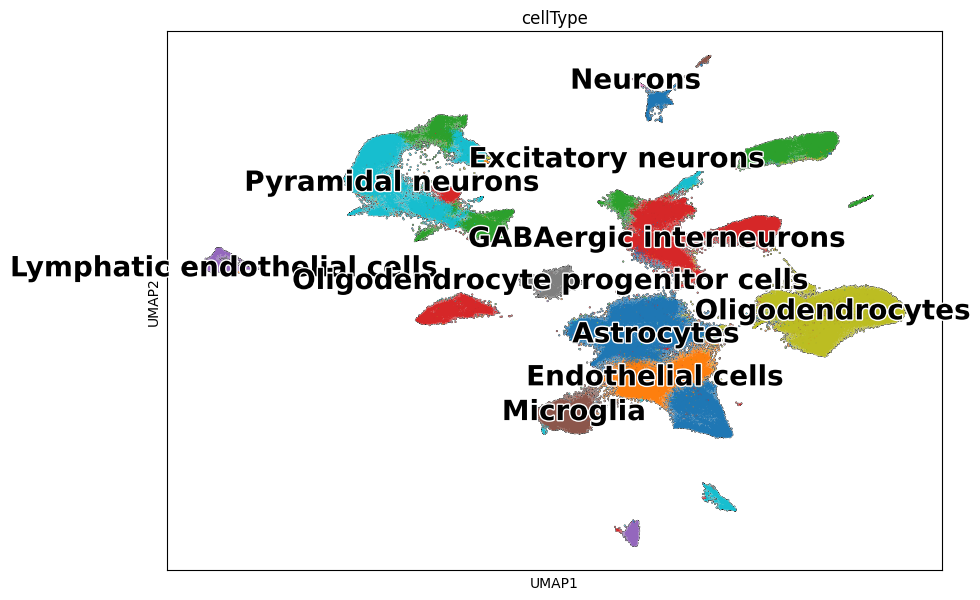

In [30]:
plt.rcdefaults()
with plt.rc_context({'figure.figsize': (10, 7)}):
    sc.pl.umap(ad,color = ("cellType"),s=3,add_outline=True,legend_loc='on data',legend_fontsize=20,legend_fontoutline=2, ncols= 1, )

Xenium_V1_FFPE_TgCRND8_5_7_months_outs


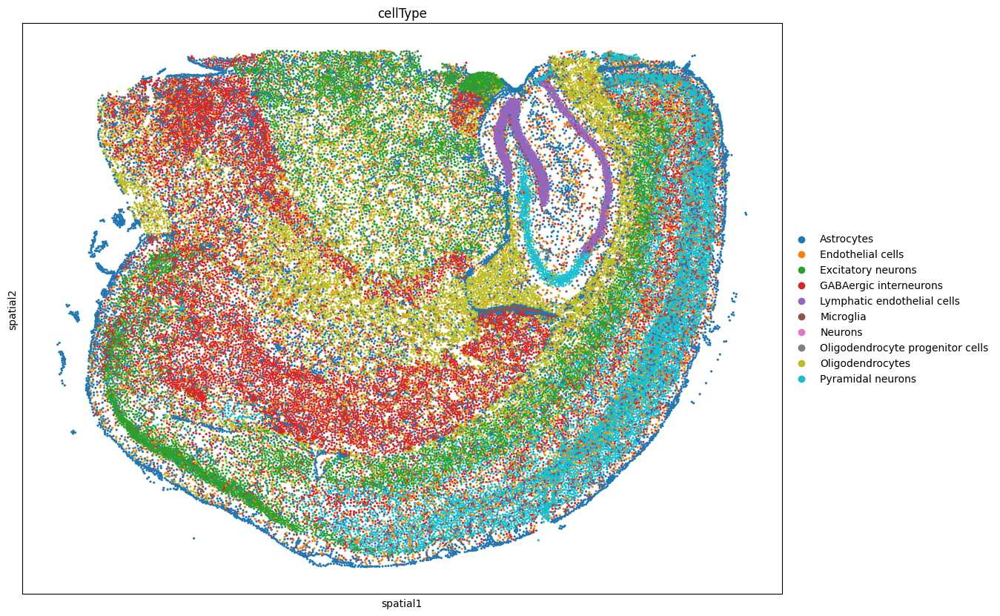

Xenium_V1_FFPE_wildtype_2_5_months_outs


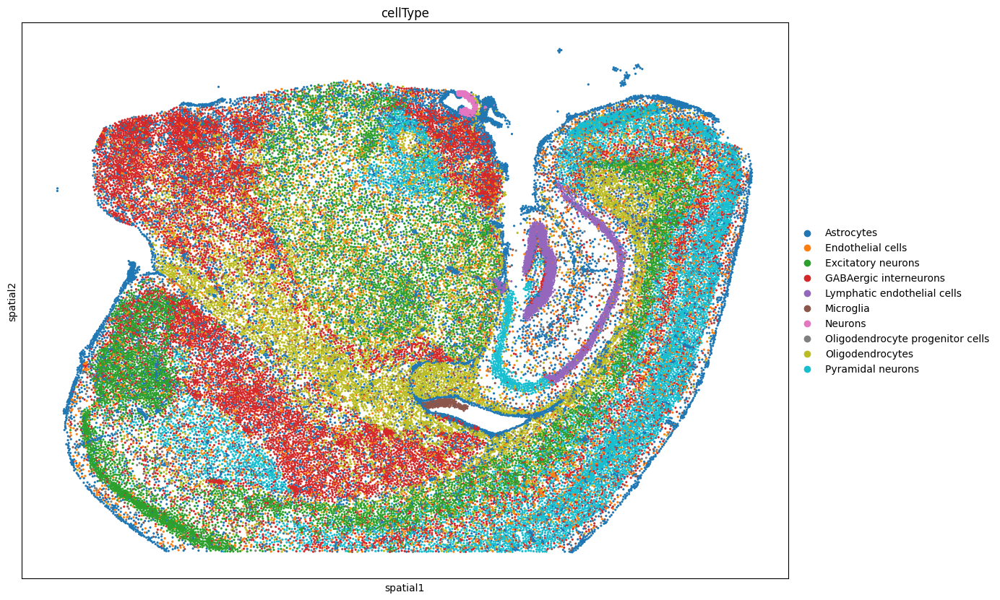

Xenium_V1_FFPE_wildtype_13_4_months_outs


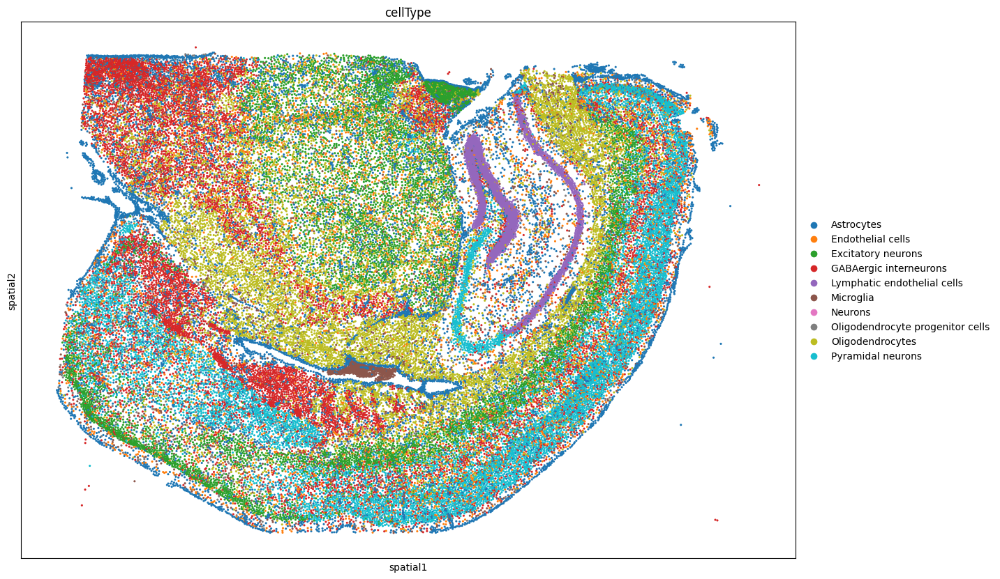

Xenium_V1_FFPE_wildtype_5_7_months_outs


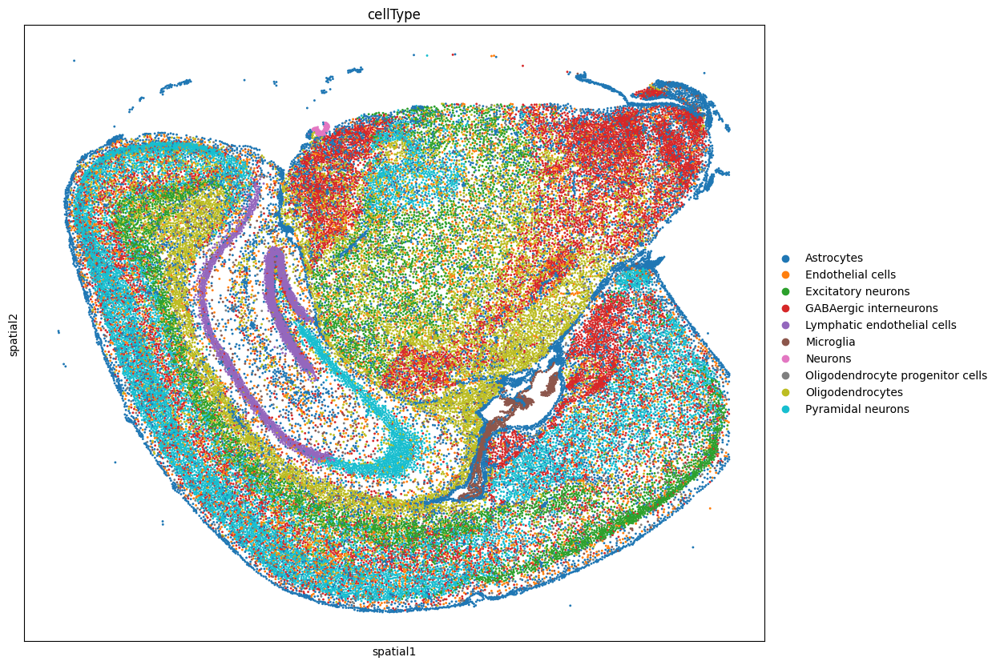

Xenium_V1_FFPE_TgCRND8_2_5_months_outs


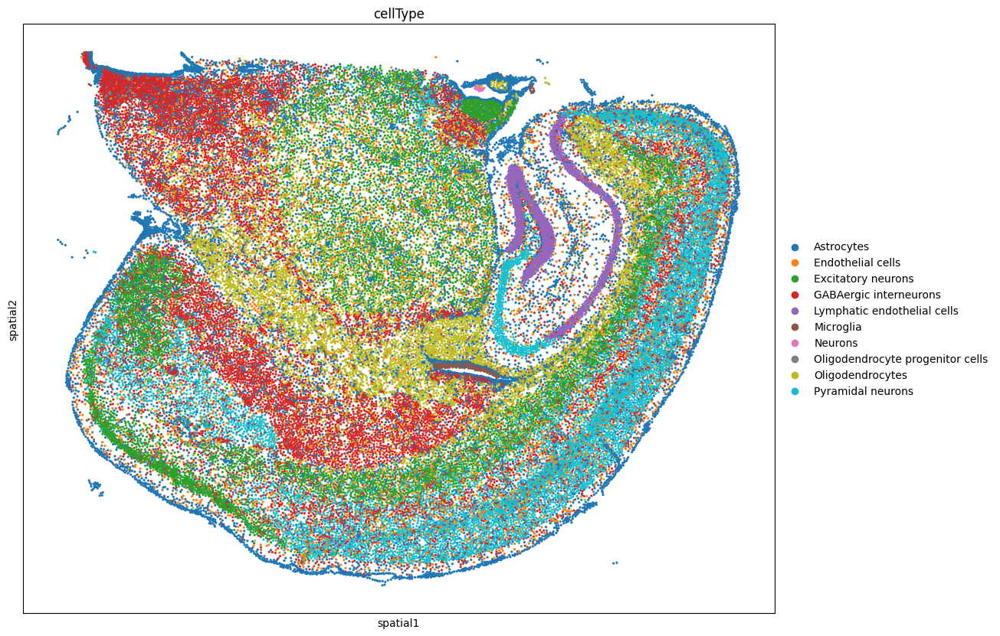

Xenium_V1_FFPE_TgCRND8_17_9_months_outs


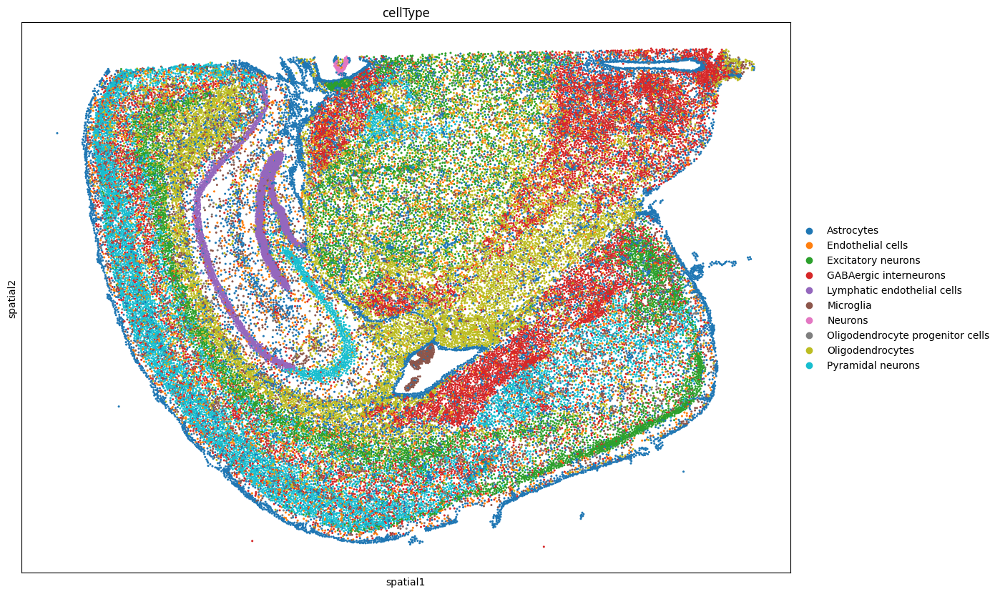

In [31]:
for run in ad.obs['run'].unique():
    print(run)
    ad_int = ad[ad.obs['run'] == run]
    with plt.rc_context({'figure.figsize': (20, 10)}):
        sc.pl.spatial(ad_int, spot_size=20, color = 'cellType')
    plt.show()
    

In [32]:
adata = ad.copy()

In [33]:
import pandas as pd
import numpy as np

# your mapping list
meta = [
    {'sample': 'Xenium_V1_FFPE_TgCRND8_5_7_months_outs','model': 'TgCRND8','age': '5_7_months'},
    {'sample': 'Xenium_V1_FFPE_wildtype_2_5_months_outs','model': 'wildtype','age': '2_5_months'},
    {'sample': 'Xenium_V1_FFPE_wildtype_13_4_months_outs','model': 'wildtype','age': '13_4_months'},
    {'sample': 'Xenium_V1_FFPE_wildtype_5_7_months_outs','model': 'wildtype','age': '5_7_months'},
    {'sample': 'Xenium_V1_FFPE_TgCRND8_2_5_months_outs','model': 'TgCRND8','age': '2_5_months'},
    {'sample': 'Xenium_V1_FFPE_TgCRND8_17_9_months_outs','model': 'TgCRND8','age': '17_9_months'},
]
meta_df = pd.DataFrame(meta)

# pick your obs column that contains these sample names
sample_col = "run" if "sample" in ad.obs.columns else "run"

# merge onto obs
obs = ad.obs.reset_index(drop=False)  # keep cell index
merged = obs.merge(meta_df, left_on=sample_col, right_on="sample", how="left")

# write back
ad.obs["model"] = merged["model"].values
ad.obs["age_str"] = merged["age"].values

# optional: parse "5_7_months" -> 5.7 (float months)
def parse_age(a):
    if pd.isna(a): return np.nan
    s = str(a).replace("_months","")
    try:
        major, minor = s.split("_", 1)
        return float(f"{int(major)}.{int(minor)}")
    except Exception:
        # fallback: just take the first number
        nums = "".join(ch if ch.isdigit() or ch=="." else " " for ch in s).split()
        return float(nums[0]) if nums else np.nan

ad.obs["age_months"] = ad.obs["age_str"].apply(parse_age)

# make tidy categoricals (optional)
ad.obs["model"] = pd.Categorical(ad.obs["model"], categories=["wildtype","TgCRND8"], ordered=True)

# sanity check
print(ad.obs[["sample" if "sample" in adata.obs else "run", "model", "age_str", "age_months"]].head())

                                               run    model     age_str  \
cell_id                                                                   
aaabaohn-1  Xenium_V1_FFPE_TgCRND8_5_7_months_outs  TgCRND8  5_7_months   
aaabocno-1  Xenium_V1_FFPE_TgCRND8_5_7_months_outs  TgCRND8  5_7_months   
aaadpgin-1  Xenium_V1_FFPE_TgCRND8_5_7_months_outs  TgCRND8  5_7_months   
aaaecjii-1  Xenium_V1_FFPE_TgCRND8_5_7_months_outs  TgCRND8  5_7_months   
aaaegkaj-1  Xenium_V1_FFPE_TgCRND8_5_7_months_outs  TgCRND8  5_7_months   

            age_months  
cell_id                 
aaabaohn-1         5.7  
aaabocno-1         5.7  
aaadpgin-1         5.7  
aaaecjii-1         5.7  
aaaegkaj-1         5.7  


In [34]:
ad_OL = ad[ad.obs.cellType.str.contains('Oligo')]

In [35]:
ad.obs.model.unique()

['TgCRND8', 'wildtype']
Categories (2, object): ['wildtype' < 'TgCRND8']

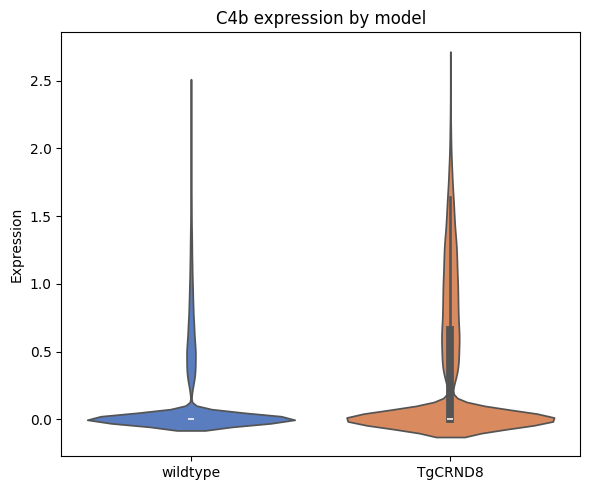

In [36]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# pick gene
gene = "C4b"

# extract expression vector
if gene not in ad.var_names:
    raise ValueError(f"{gene} not found in adata.var_names")

c4b_expr = ad_OL[:, gene].X
if hasattr(c4b_expr, "toarray"):  # handle sparse matrix
    c4b_expr = c4b_expr.toarray().ravel()
else:
    c4b_expr = np.asarray(c4b_expr).ravel()

# build dataframe
df = pd.DataFrame({
    "C4b_expr": c4b_expr,
    "model": ad_OL.obs["model"].values
})

plt.figure(figsize=(6,5))
sns.violinplot(data=df, x="model", y="C4b_expr", inner="box", palette="muted")
plt.title("C4b expression by model")
plt.ylabel("Expression")
plt.xlabel("")
plt.tight_layout()
plt.show()

... storing 'age_str' as categorical


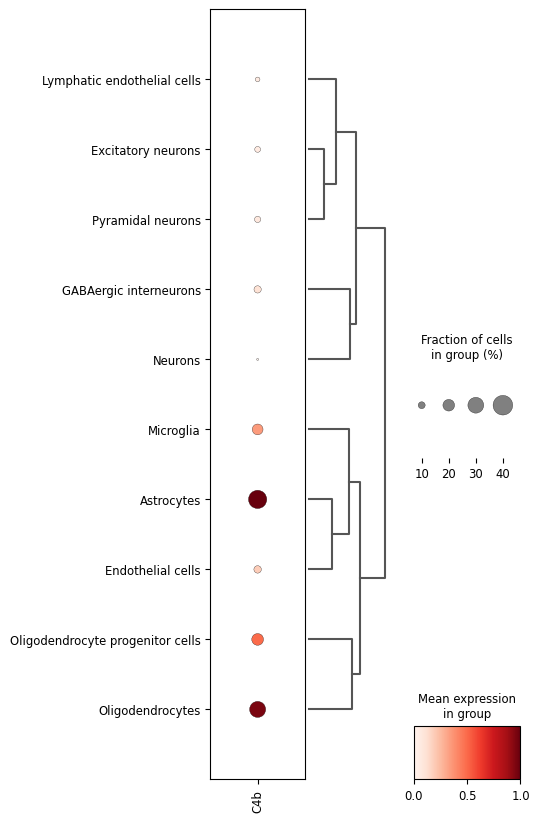

In [37]:
 sc.pl.dotplot(
        ad,
        var_names='C4b',
        groupby="cellType",
        standard_scale="var",
        #dot_max=0.5,
        #dot_min=0.05,
        color_map="Reds",
        dendrogram=True,
        figsize=(4, 10)
    )

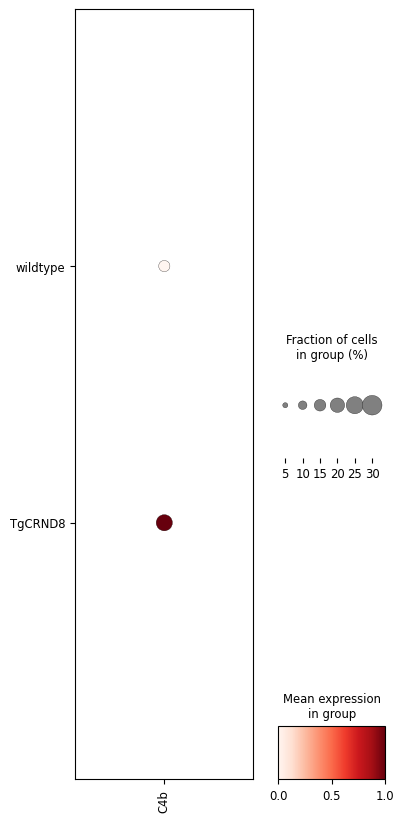

In [38]:
 sc.pl.dotplot(
        ad,
        var_names='C4b',
        groupby="model",
        standard_scale="var",
        #dot_max=0.5,
        #dot_min=0.05,
        color_map="Reds",
        dendrogram=True,
        figsize=(4, 10)
    )

In [39]:
import numpy as np
import pandas as pd

# Subset to DA-oligos only
da_oligos = ad[ad.obs["cellType"] == "Oligodendrocytes", :]
da_oligos = da_oligos[da_oligos.obs["model"] != "wildetype", :]

# Extract C4b expression vector
c4b_idx = da_oligos.var_names.get_loc("C4b")
c4b_expr = da_oligos.X[:, c4b_idx].toarray().ravel() if hasattr(da_oligos.X, "toarray") else da_oligos.X[:, c4b_idx].ravel()

# Convert X to dense DataFrame
X = da_oligos.to_df()

# Compute correlations with C4b
cors = X.corrwith(pd.Series(c4b_expr, index=X.index))

# Compute mean expression per gene
means = X.mean()

# Build combined DataFrame
results = pd.DataFrame({
    "gene": cors.index,
    "corr_with_C4b": cors.values,
    "mean_expression": means.values
})

# Sort by correlation
results = results.sort_values("corr_with_C4b", ascending=False).reset_index(drop=True)

# Top 30
top_genes = results.head(50)


In [40]:
top_genes = top_genes[top_genes.corr_with_C4b < 1]

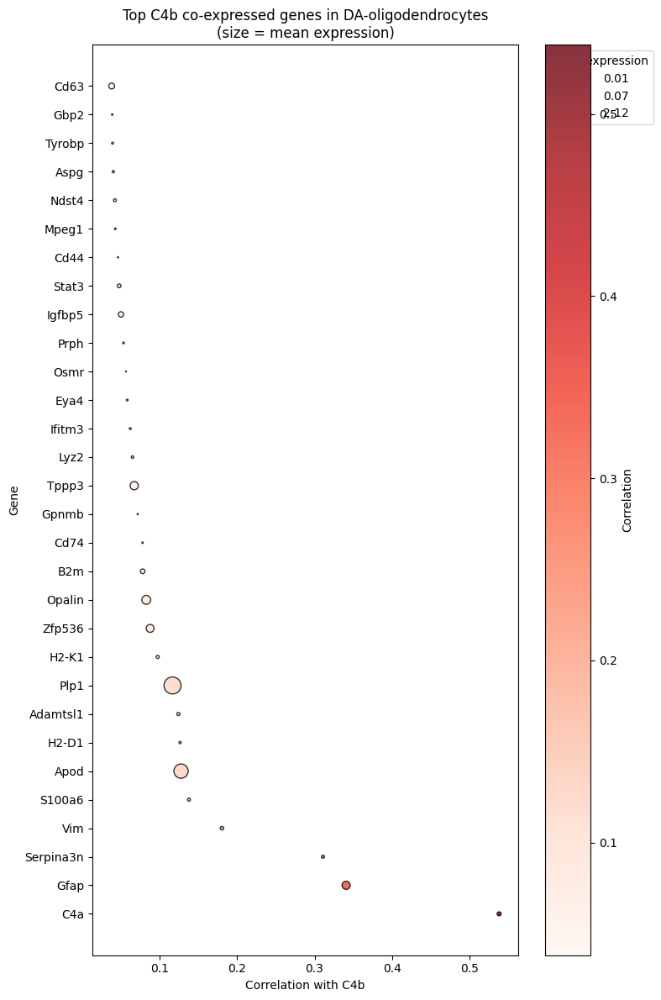

In [41]:
import matplotlib.pyplot as plt

def dotplot_corr_expr(results, top_n=30):
    """
    Dotplot of genes ranked by correlation with C4b.
    Dot size = mean expression, Dot color = correlation with C4b.
    """
    df = results.sort_values("corr_with_C4b", ascending=False).head(top_n)

    plt.figure(figsize=(8, 0.4*top_n))
    sc = plt.scatter(
        x=df["corr_with_C4b"],
        y=df["gene"],
        s=df["mean_expression"]*100,   # scale size by mean expression
        c=df["corr_with_C4b"],
        cmap="Reds",
        alpha=0.8,
        edgecolor="k"
    )

    plt.xlabel("Correlation with C4b")
    plt.ylabel("Gene")
    plt.colorbar(sc, label="Correlation")
    plt.title("Top C4b co-expressed genes in DA-oligodendrocytes\n(size = mean expression)")

    # --- add size legend, positioned outside ---
    sizes = [df["mean_expression"].min(), df["mean_expression"].median(), df["mean_expression"].max()]
    labels = [f"{s:.2f}" for s in sizes]
    handles = [plt.scatter([], [], s=s*100, color="gray", alpha=0.6, edgecolor="k") for s in sizes]

    plt.legend(
        handles, labels, title="Mean expression",
        bbox_to_anchor=(1.05, 1), loc="upper left", frameon=True
    )

    plt.tight_layout()
    plt.show()

# usage
dotplot_corr_expr(top_genes, top_n=30)

# Regression-based approach

In [42]:
from sklearn.linear_model import LassoCV

X = da_oligos.to_df().drop(columns=["C4b"])
y = da_oligos.to_df()["C4b"]

lasso = LassoCV(cv=5).fit(X, y)
coefs = pd.Series(lasso.coef_, index=X.columns)
coefs = coefs[coefs != 0].sort_values(ascending=False)
print(coefs.head(20))

C4a          0.580666
Serpina3n    0.222283
Gfap         0.096168
Gpnmb        0.087943
H2-D1        0.077466
Adamtsl1     0.076691
H2-K1        0.051484
Cd74         0.049520
S100a6       0.047963
Dkk2         0.047410
Apod         0.043458
Ndst4        0.041906
Cd44         0.038922
B2m          0.038702
Aspg         0.036224
Eya4         0.034009
Opalin       0.032994
Ifitm3       0.031342
Plp1         0.031107
Fos          0.029877
dtype: float32


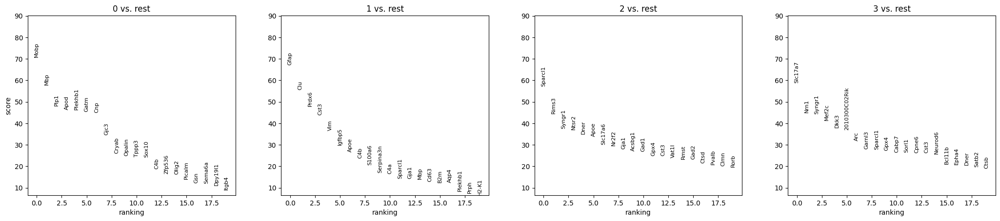

In [43]:
import scanpy as sc

adata_sub = da_oligos[da_oligos[:, "C4b"].X.A.ravel() > 0, :]
sc.pp.pca(adata_sub)
sc.pp.neighbors(adata_sub)
sc.tl.leiden(adata_sub, resolution=0.5)
sc.tl.rank_genes_groups(adata_sub, "leiden", method="wilcoxon")
sc.pl.rank_genes_groups(adata_sub)

# Mutual information (nonlinear associations)

In [44]:
from sklearn.feature_selection import mutual_info_regression

X = da_oligos.to_df().drop(columns=["C4b"])
y = da_oligos.to_df()["C4b"]

mi = mutual_info_regression(X, y)
mi_scores = pd.Series(mi, index=X.columns).sort_values(ascending=False)
print(mi_scores.head(20))

Cryab      0.903150
Itm2b      0.885526
Gatm       0.883630
Gjc3       0.852888
Gpx4       0.810915
Cnp        0.789275
Zfp536     0.743890
Apoe       0.739629
Tppp3      0.739034
Apod       0.728395
Opalin     0.720303
Sox10      0.720078
Plekhb1    0.711356
Picalm     0.704597
Clu        0.698615
Dpy19l1    0.693990
Clmn       0.688470
Prdx6      0.687076
Npc2       0.681459
Sparcl1    0.675967
dtype: float64


# Cell-level co-expression probability

In [45]:
X = da_oligos.to_df()
c4b_pos = X["C4b"] > 0

coexpr_fraction = (X.loc[c4b_pos] > 0).mean()
coexpr_fraction = coexpr_fraction.sort_values(ascending=False).head(20)

In [46]:
coexpr_fraction

C4b        1.000000
Mbp        0.999720
Plp1       0.998601
Mobp       0.993786
Apod       0.981359
Cnp        0.971787
Plekhb1    0.968932
Gatm       0.949339
Cst3       0.949227
Apoe       0.939599
Itm2b      0.924989
Cryab      0.917488
Sparcl1    0.884628
Clu        0.883789
Gjc3       0.801388
Gpx4       0.752967
Prdx6      0.710591
Opalin     0.704489
Gfap       0.687528
Tppp3      0.674093
dtype: float64

In [ ]:
ad.write('../Xenium_AD_mouse.h5ad')